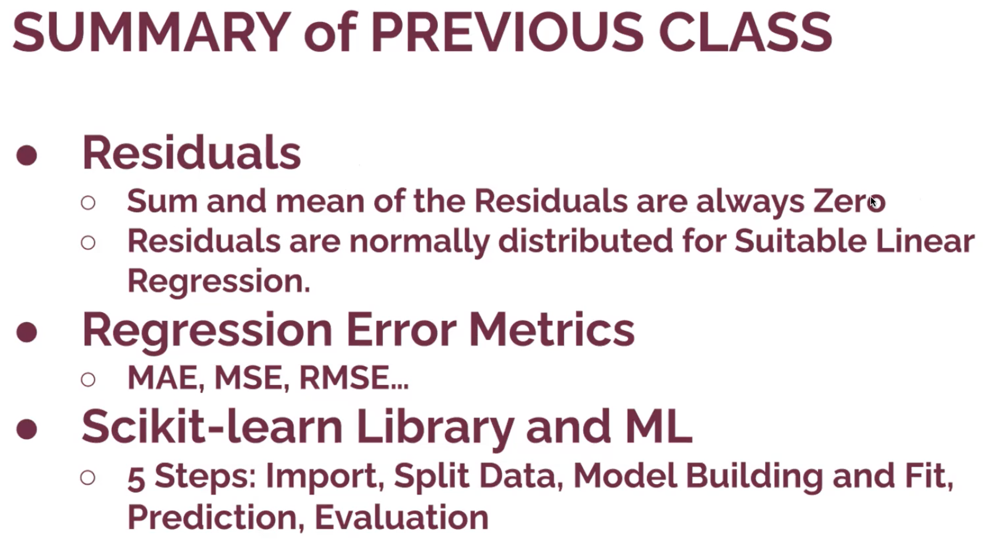

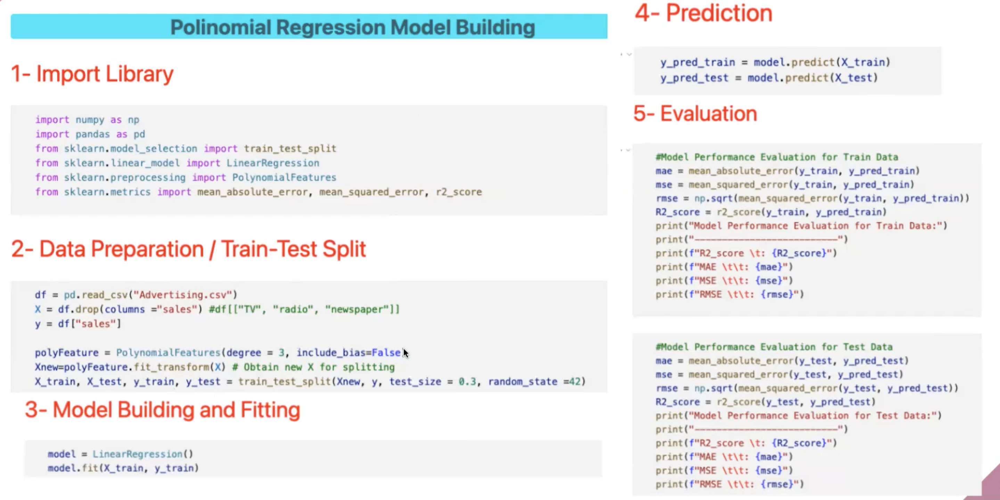

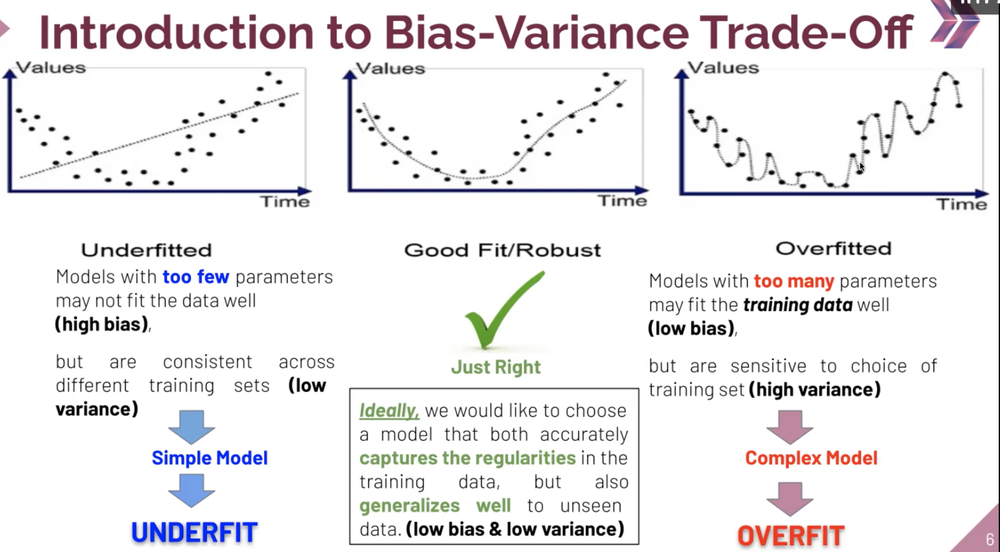

## Bias = residue 
gercek datanin, predict noktasina uzakligi : Residue = Bias 
- underfitting olursa residue=bias yuksektir, HIGH bias 
- overfitting olursa tum noktalara ulasir, LOW bias
- good fittin: bias makul seviyede dusuktur 

## Variance = Uretilen datanin degisimi 
- underfitting : kendini zorlamamis, degisim dusuk. Model ogrenememis, LOW Variance
- overfitting : variance yuksek, kendini zorlamis tum noktalara erismeye calismis, ses sinyali  yuksek frekanslidir-gurultu gibi. gurultu yuksek frekanslidir, istenmeyen data. icinde problemli data olabilir, her seyi ezberler. HIGH Variance 
- good fitting: variance ne cok yuksek ne cok dusuk 


- underfitting: hata yuksek, model cok cok basit oldugu icin ogrenemiyor, data cok azsa o yuzden de underfitting olabilir
- overfitting: model complexity arttikca error artiyor, data cok ise kafa karisabilir overfitting olabilir, capraz dogrulamalarla bakmak gerekir(?)

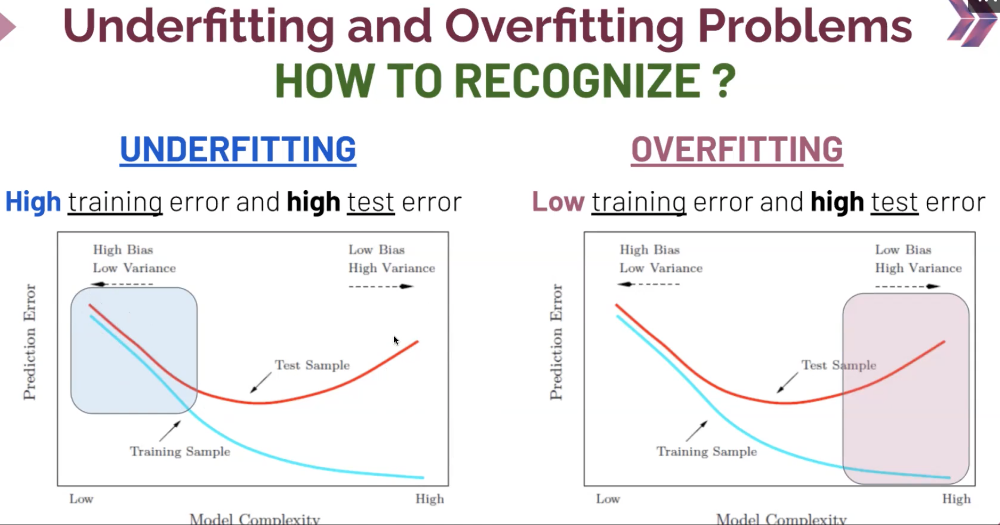

model cok basitse underfitting, ogrenemez. soldaki mavi tarali alan ornek
- ogrenemezse hata buyuk olur 
- hem training hem de testte hata yuksek olur 

overfitting, ornek olarak sagdaki pembe tarali alan
- trainingteki hata cok dusuk, testte hata yuksek 
- model complex arttikca test sampleda hata daha da artar 

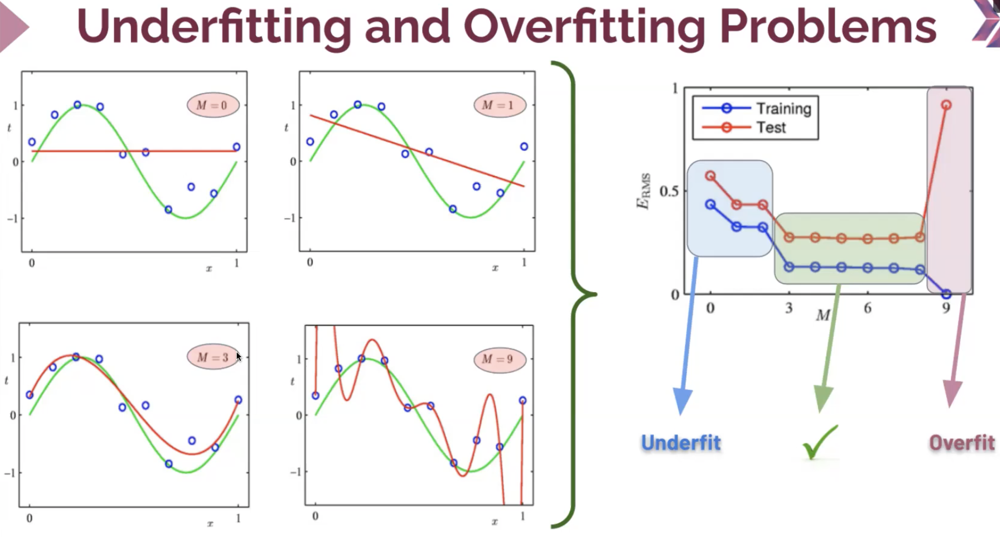

-- yesil en iyi fit nokta 
-- varyans kirmizinin noktalara uzakligi 
- model 0: duz cizgi, varyans yuksek, under fitting
- model 1: komplexiti 1, varyans yuksek, under fitting 
- model 3: 3.dereceden modelin ciktisi olmus (kirmizi, regression egrisi). yesil ideale yakin cizgiye yakin, varyansta ani degisiklikler yok, LOW varyans 
- model 9: extrem noktalari tepe/donum noktalari var. muthis degisim var, varyans cok yuksek, bias cok dusuk 


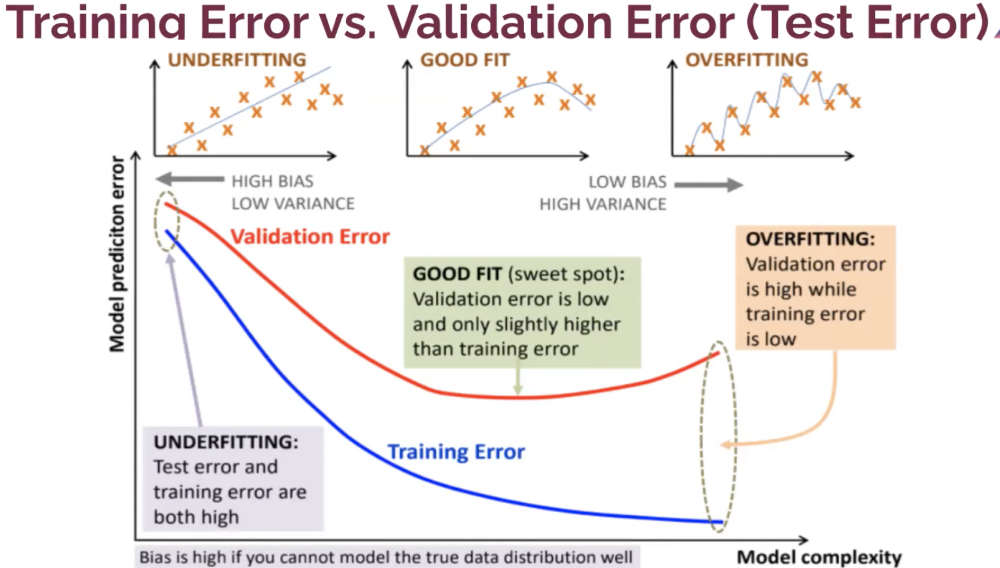

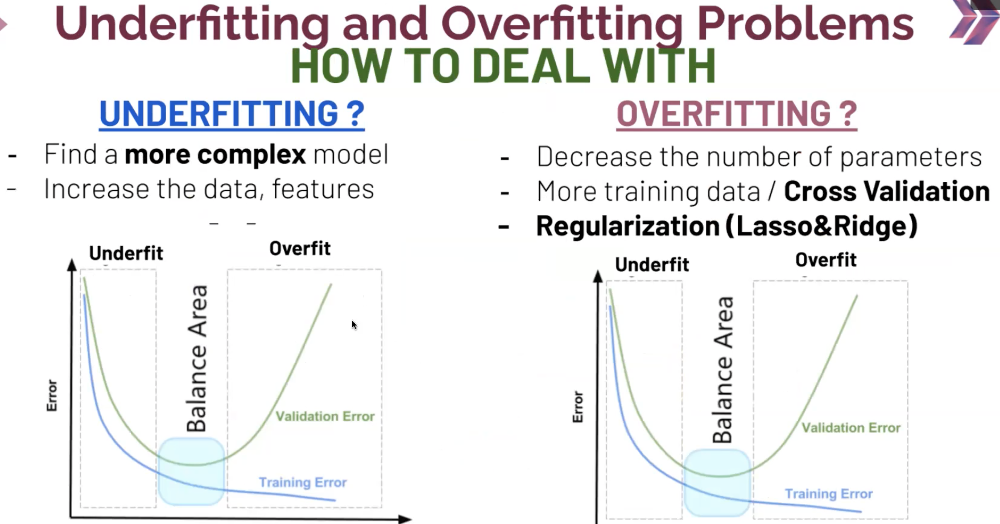

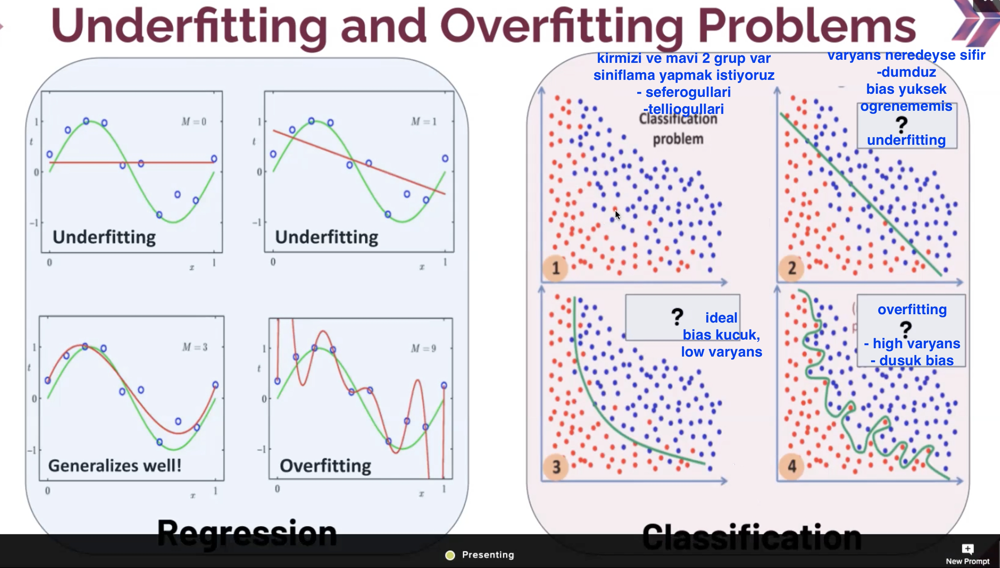

<a id = '4.0'></a>
<p style = "font-size : 35px; color : #34656d ;  text-align : center; background-color : #08f9f9; border-radius: 5px 5px;"><strong>Poliynomial Regression-Overfiting-Underfiting</strong></p> 

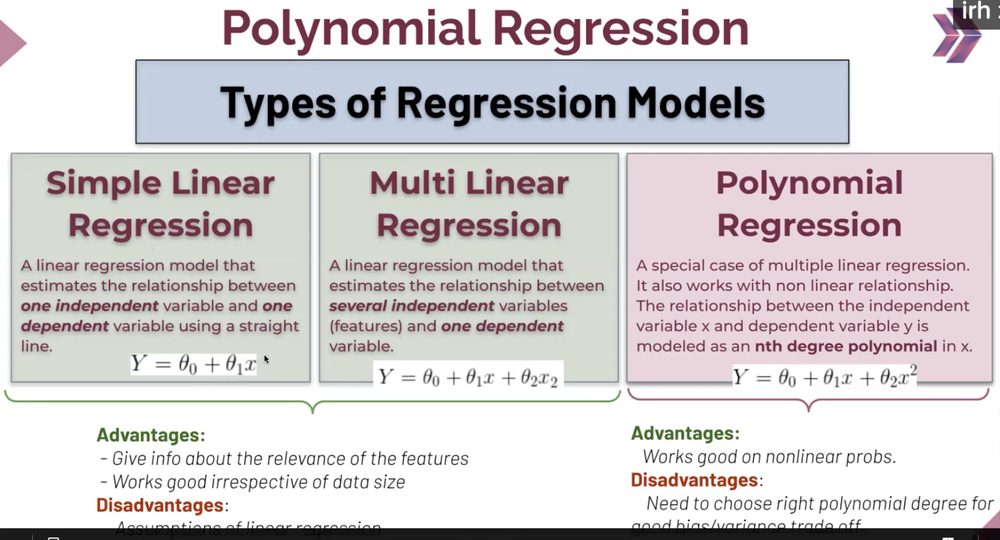

multilineer: 
Polinomal: kare-kup geliyorsa 
toplamsallik ve carpimsallik sagliyorsa lineerdir, 
kare-kup vs varsa bunu saglamaz, polinom olur

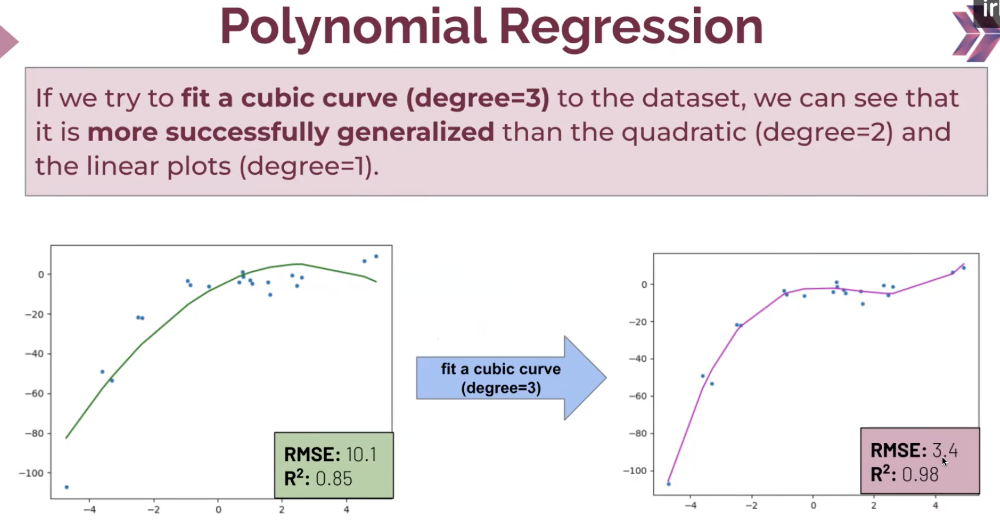

polinom derece arttikca trainingde hata azaliyor. 
- rmse cok azaldi
- testte de hata azalirsa iyi, ama test ederken hata artarsa overfitting olur
- o zaman bir derece ineriz 

Polynomial Regression is a form of regression analysis in which the relationship 
between the independent variables and dependent variables are modeled in the nth degree polynomial.

Polinom Regresyon , bağımsız değişkenler ile bağımlı değişkenler arasındaki ilişkinin n'inci derece 
polinomda modellendiği bir regresyon analizi şeklidir.

Types of polinomials

1st degree ---> linear    b1x + b0

2nd degree ---> Quadratic b2x**2 + b1x + b0

3rd degree ---> Cubic     b3x**3 + b2x**2 + b1x + b0

## Import libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams["figure.figsize"] = (10,6)
import warnings 
warnings.filterwarnings('ignore')

## Polynomial Features

In [2]:
from sklearn.preprocessing import PolynomialFeatures

In [3]:
data = np.array([[2, 3, 4]]) 
print(data)

[[2 3 4]]


In [4]:
trans = PolynomialFeatures(degree = 2, include_bias =False)
# kacinci dereceden bir polinom istiyoruz
# datayi polinomal degere getirdik (degree=2 ile 2. dereceden polinom)
# bias olmasin, islem kolayligi icin false 

In [5]:
trans.fit(data) # 2, 3, 4 , 2x3, 2x4, 3x4, 2**2, 3**2, 4**2
# datayi degisik katssayilara donusturuyor 
# polinomsal olarak kendi icinde datayi polinoma fit ediyor 

PolynomialFeatures(include_bias=False)

In [6]:
# 2, 3, 4, 2x3, 2x4, 3x4, 2**2, 3**2, 4**2, 2x3x4, 3x2**2, 4x2**2, 2x3**2, 4x3**2, 2x4**2, 3x4**2, 2**3, 3**3, 4**3

In [7]:
trans.transform(data)
# data'yi tamamen donusturur 
# 3 feature'dan olusan array, 9 featureluk hale geliyor
# feature cogullama yapip yeni feturelar elde ediyor 

array([[ 2.,  3.,  4.,  4.,  6.,  8.,  9., 12., 16.]])

In [8]:
trans.fit_transform(data) # combining method
# fit ve transformu tek islemde yapiyor 

array([[ 2.,  3.,  4.,  4.,  6.,  8.,  9., 12., 16.]])

## Read Dataset

In [9]:
df = pd.read_csv("Advertising.csv")

In [10]:
df

,TV,radio,newspaper,sales
0,230.1,37.8,69.2,22.1
1,44.5,39.3,45.1,10.4
2,17.2,45.9,69.3,9.3
3,151.5,41.3,58.5,18.5
4,180.8,10.8,58.4,12.9
...,...,...,...,...
195,38.2,3.7,13.8,7.6
196,94.2,4.9,8.1,9.7
197,177.0,9.3,6.4,12.8
198,283.6,42.0,66.2,25.5


In [16]:
df.shape

(200, 4)

## Polynomial Converter

In [11]:
X = df.drop("sales", axis =1)
y = df.sales
# target ve feature olusturduk

In [12]:
polynomial_converter = PolynomialFeatures(degree =2, include_bias =False)
# converter ile kacinci dereceden olsun? 

In [13]:
polynomial_converter.fit(X)
# datanin hepsini fit ettik

PolynomialFeatures(include_bias=False)

In [14]:
poly_features = polynomial_converter.transform(X)
# transform ile featurelari cogulladik

In [15]:
poly_features

array([[ 230.1 ,   37.8 ,   69.2 , ..., 1428.84, 2615.76, 4788.64],
       [  44.5 ,   39.3 ,   45.1 , ..., 1544.49, 1772.43, 2034.01],
       [  17.2 ,   45.9 ,   69.3 , ..., 2106.81, 3180.87, 4802.49],
       ...,
       [ 177.  ,    9.3 ,    6.4 , ...,   86.49,   59.52,   40.96],
       [ 283.6 ,   42.  ,   66.2 , ..., 1764.  , 2780.4 , 4382.44],
       [ 232.1 ,    8.6 ,    8.7 , ...,   73.96,   74.82,   75.69]])

In [36]:
poly_features.shape
# 3 feature 9'a cikti

(200, 9)

In [17]:
pd.DataFrame(poly_features, columns = ["TV", "radio", "newspaper", "TV^2", "TV&Radio", \
                                   "TV&Newspaper", "Radio^2", "Radio&newspaper", "Newspaper^2"]).head()

,TV,radio,newspaper,TV^2,TV&Radio,TV&Newspaper,Radio^2,Radio&newspaper,Newspaper^2
0,230.1,37.8,69.2,52946.01,8697.78,15922.92,1428.84,2615.76,4788.64
1,44.5,39.3,45.1,1980.25,1748.85,2006.95,1544.49,1772.43,2034.01
2,17.2,45.9,69.3,295.84,789.48,1191.96,2106.81,3180.87,4802.49
3,151.5,41.3,58.5,22952.25,6256.95,8862.75,1705.69,2416.05,3422.25
4,180.8,10.8,58.4,32688.64,1952.64,10558.72,116.64,630.72,3410.56


In [18]:
X.shape

(200, 3)

## Train | Test Split

In [19]:
from sklearn.model_selection import train_test_split

In [20]:
X_train, X_test, y_train, y_test = train_test_split(poly_features,
                                                    y,
                                                    test_size=0.3,
                                                    random_state=101)

X_train ve poly_feature

In [21]:
X_train.shape

(140, 9)

In [23]:
poly_features.shape

(200, 9)

## Model for fitting

In [24]:
from sklearn.linear_model import LinearRegression

In [25]:
model_poly = LinearRegression()

In [26]:
model_poly.fit(X_train, y_train)

LinearRegression()

In [27]:
y_pred = model_poly.predict(X_test)

In [28]:
my_dict = {"Actual": y_test, "pred": y_pred, "residual": y_test-y_pred}
compare = pd.DataFrame(my_dict)
compare.head(20)

,Actual,pred,residual
37,14.7,13.948562,0.751438
109,19.8,19.334803,0.465197
31,11.9,12.319282,-0.419282
89,16.7,16.762863,-0.062863
66,9.5,7.902109,1.597891
119,6.6,6.941438,-0.341438
54,20.2,20.133727,0.066273
74,17.0,17.500927,-0.500927
145,10.3,10.568890,-0.268890
142,20.1,20.125518,-0.025518


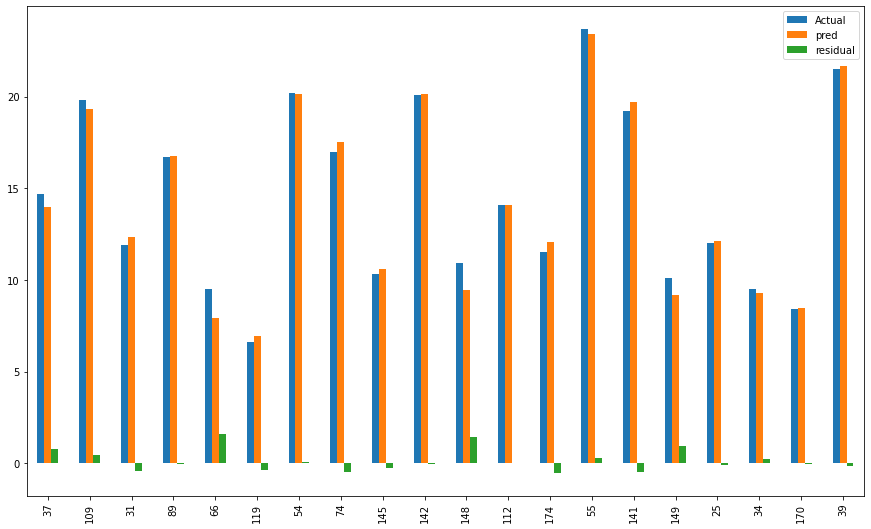

In [29]:
compare.head(20).plot(kind='bar',figsize=(15,9))
plt.show();

## Poly Coefficients

In [30]:
model_poly.coef_

array([ 5.17095811e-02,  1.30848864e-02,  1.20000085e-02, -1.10892474e-04,
        1.14212673e-03, -5.24100082e-05,  3.34919737e-05,  1.46380310e-04,
       -3.04715806e-05])

In [31]:
df_coef = pd.DataFrame(model_poly.coef_, index = ["TV", "radio", "newspaper", "TV^2", "TV&Radio", \
                                   "TV&Newspaper", "Radio^2", "Radio&newspaper", "Newspaper^2"], columns = ["coef"])

In [32]:
df_coef

,coef
TV,0.051710
radio,0.013085
newspaper,0.012000
TV^2,-0.000111
TV&Radio,0.001142
TV&Newspaper,-0.000052
Radio^2,0.000033
Radio&newspaper,0.000146
Newspaper^2,-0.000030


In [33]:
model_poly.predict([[2.301000e+02, 3.780000e+01, 6.920000e+01, 5.294601e+04,
       8.697780e+03, 1.592292e+04, 1.428840e+03, 2.615760e+03,
       4.788640e+03]])

array([21.86190699])

## Evaluation on the Test Set

In [34]:
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [35]:
y_pred = model_poly.predict(X_test)

In [36]:
def eval_metric(actual, pred):
    mae = mean_absolute_error(actual, pred)
    mse = mean_squared_error(actual, pred)
    rmse = np.sqrt(mean_squared_error(actual, pred))
    R2_score = r2_score(actual, pred)
    print("Model performance:")
    print("--------------------------")
    print(f"R2_score \t: {R2_score}")
    print(f"MAE \t\t: {mae}")
    print(f"MSE \t\t: {mse}")
    print(f"RMSE \t\t: {rmse}")

In [37]:
eval_metric(y_test, y_pred)

Model performance:
--------------------------
R2_score 	: 0.9843529333146782
MAE 		: 0.4896798044803855
MSE 		: 0.4417505510403794
RMSE 		: 0.6646431757269305


In [39]:
y_train_pred = model_poly.predict(X_train)

In [40]:
eval_metric(y_train, y_train_pred)
# train icindeki 0.98 r2score olmasi acaba overfitting mi var dedirtti 
# test icindeki degerin de 0.98 olmasi overfitting olmadigini gosterdi 
# R2Score train'de cok iyi, test kotu olsaydi overfitting
# ikisi de cok kotu olsaydi underfitting olurdu

Model performance:
--------------------------
R2_score 	: 0.9868638137712757
MAE 		: 0.4049248139151678
MSE 		: 0.34569391424439977
RMSE 		: 0.5879574085292231


* Simple Linear Regression:
    * MAE      : 1.213
    * RMSE     : 1.516
    * r2_score : 0.8609

* Polynomial 2-degree:
    * MAE      : 0.48
    * RMSE     : 0.66
    * r2_score : 0.9868

## Optimal Degree of Polynom

In [41]:
def poly(d):

    train_rmse_errors = []
    test_rmse_errors = []
    number_of_features = []
    degrees = []
# bos array olarak olusturduk 
# d derece gosteriyor 
# 1'den d'ye kadar islem yapip hatalari gosterecek

    for i in range(1, d):
        polynomial_converter = PolynomialFeatures(degree=i, include_bias=False)
        poly_features = polynomial_converter.fit_transform(X)
# once polinomu convert ettik 
# fit_transfer iki islemi de yaptik 
        X_train, X_test, y_train, y_test = train_test_split(poly_features,
                                                            y,
                                                            test_size=0.3,
                                                            random_state=101)
# poly_features olsun dedik 
# modeli olusturduk, fit ettik 
        model = LinearRegression(fit_intercept=True)
        model.fit(X_train, y_train)
# train ve test icin predict yaptik 
        train_pred = model.predict(X_train)
        test_pred = model.predict(X_test)

# train ve test icin hatalari hesapladik 
        train_RMSE = np.sqrt(mean_squared_error(y_train, train_pred))
        test_RMSE = np.sqrt(mean_squared_error(y_test, test_pred))

        train_rmse_errors.append(train_RMSE)
        test_rmse_errors.append(test_RMSE)

        number_of_features.append(poly_features.shape[1])
        degrees.append(i)
# poly_feature ile featurelari cogulladik, sayisini aldik 
# degree ile kacinci derecede oldugunu aldik 
    return pd.DataFrame(
        {
            "train_rmse_errors": train_rmse_errors,
            "test_rmse_errors": test_rmse_errors,
            "number of features": number_of_features,
            "Degree": degrees
        },
        index=range(1, d))

In [42]:
poly(10)
# 10.derece polinoma kadar feature ve hatalari hesapladi 
# 1.derece lineer demek
# derece 2'ye 3 ve 4'e cikarttikca hatalar dustu 
# 5.derecede testte hatalar artmaya basladi 
# 5.dereceden sonra test hatalari cok artiyor 

,train_rmse_errors,test_rmse_errors,number of features,Degree
1,1.734594,1.516152,3,1
2,0.587957,0.664643,9,2
3,0.433934,0.580329,19,3
4,0.351708,0.507774,34,4
5,0.250934,2.575825,55,5
6,0.199407,4.490840,83,6
7,5.421422,1381.404069,119,7
8,0.142497,4449.567306,164,8
9,0.166521,95891.237158,219,9


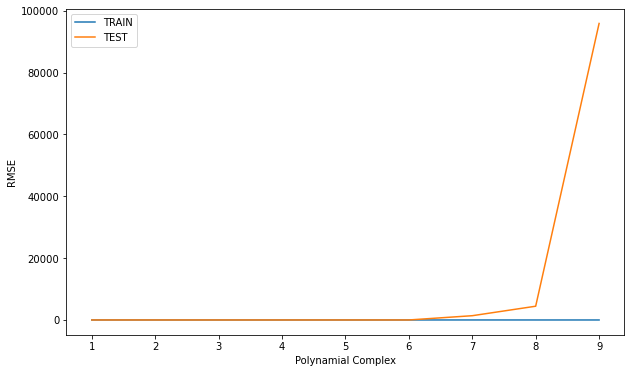

In [43]:
plt.plot(range(1,10), poly(10)["train_rmse_errors"], label = "TRAIN")
plt.plot(range(1,10), poly(10)["test_rmse_errors"], label = "TEST")
plt.xlabel("Polynamial Complex")
plt.ylabel("RMSE")
plt.legend();

# her bir derece icin hatalarin cizdirilmesi 

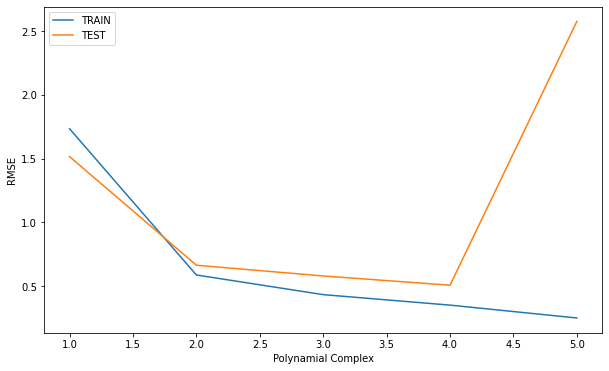

In [44]:
plt.plot(range(1,6), poly(6)["train_rmse_errors"], label = "TRAIN")
plt.plot(range(1,6), poly(6)["test_rmse_errors"], label = "TEST")
plt.xlabel("Polynamial Complex")
plt.ylabel("RMSE")
plt.legend();
# 1 ve 6. dereceleri detayli incelersek 
# model 1'de test ve trainde hata yuksek - underfitting 
# model 6: train hata cok dusuk ama test hata cok yuksek- overfitting  
# model 4: overfitting'e cok yakin. Data ilerde degistiginde riskli durum yaratir
# riski minimize etmek icin model 3 demek mantikli

In [45]:
poly(30)
# inceledik 

,train_rmse_errors,test_rmse_errors,number of features,Degree
1,1.734594,1.516152e+00,3,1
2,0.587957,6.646432e-01,9,2
3,0.433934,5.803287e-01,19,3
4,0.351708,5.077743e-01,34,4
5,0.250934,2.575825e+00,55,5
6,0.199407,4.490840e+00,83,6
7,5.421422,1.381404e+03,119,7
8,0.142497,4.449567e+03,164,8
9,0.166521,9.589124e+04,219,9
10,0.203514,6.103790e+05,285,10


## Finalizing Model Choice

In [46]:
final_poly_converter = PolynomialFeatures(degree=3, include_bias=False)

In [47]:
final_model = LinearRegression()

In [48]:
final_model.fit(final_poly_converter.fit_transform(X), y)

LinearRegression()

## Predictions

In [49]:
new_record = [[150, 20, 15]]

In [50]:
new_record_poly = final_poly_converter.fit_transform(new_record)

In [51]:
new_record_poly

array([[1.500e+02, 2.000e+01, 1.500e+01, 2.250e+04, 3.000e+03, 2.250e+03,
        4.000e+02, 3.000e+02, 2.250e+02, 3.375e+06, 4.500e+05, 3.375e+05,
        6.000e+04, 4.500e+04, 3.375e+04, 8.000e+03, 6.000e+03, 4.500e+03,
        3.375e+03]])

In [52]:
final_model.predict(new_record_poly) 

array([14.24950844])

## <span style='color:red'> Overfitting</span> 

In [53]:
over_poly_converter = PolynomialFeatures(degree =5, include_bias =False)

In [54]:
over_model = LinearRegression()

In [55]:
X_train, X_test, y_train, y_test = train_test_split(over_poly_converter.fit_transform(X), y, test_size=0.3, random_state=101)

In [56]:
over_model.fit(X_train, y_train)

LinearRegression()

In [57]:
y_pred_over = over_model.predict(X_test)
eval_metric(y_test, y_pred_over)

Model performance:
--------------------------
R2_score 	: 0.7649888518703625
MAE 		: 0.6659574891491746
MSE 		: 6.634873249711867
RMSE 		: 2.5758247707699113


In [58]:
y_train_over = over_model.predict(X_train)
eval_metric(y_train, y_train_over)

Model performance:
--------------------------
R2_score 	: 0.9976072484653282
MAE 		: 0.18621400407821548
MSE 		: 0.06296802050706767
RMSE 		: 0.2509342951990972


## <span style='color:red'> Underfitting</span> 